# Part 4. Machine Learning

In [1]:
from utils import *
plt.style.use('fivethirtyeight')

# Load Pre-Processed Data and Prepare Features for Machine Learning

In [33]:
tweet_stocks = pd.read_pickle('./data/pre_processed_df.pkl')

In [35]:
new_df = pd.DataFrame()
labels = ['move','stay', 'move']
for user in list(tweet_stocks['username'].unique()):
    df = tweet_stocks[tweet_stocks['username'] == user]
    bins = [df['percent change'].min(), -0.025, 0.025, df['percent change'].max()]
    df['movement'] = pd.cut(df['percent change'], bins=bins, labels=labels, include_lowest=True, ordered=False)
    new_df = new_df.append(df)
    new_df.reset_index(inplace=True, drop=True)
tweet_stocks = new_df 

In [36]:
#df = tweet_stocks[tweet_stocks['username'] != 'richardbranson']

In [37]:
#branson = branson['2019-10-20':]
#branson.reset_index(inplace=True)
#df = df.append(branson)

In [38]:
numerical_feat = [
    'mentions', 'hashtags',
       'video', 'photos', 'urls',
       'number of tweets',
       'number of emojis', 'tweet length', 'number of sentences',
       'number of words', 'avg words per sentence', 'number of nouns',
       'number of verbs', 'number of stopwords', 'number of organizations',
       ]
text_feat = ['tweet', 'text', 'cleaned']
targets = []
all_scores = {}
cv_scores = {}
models = {}

In [39]:
labels = ['stay', 'move']
col_name = 'bins'
bin_name = 'bins'
df = tweet_stocks.copy(deep=True)
text_name = 'cleaned'
col_name = 'movement'
target_name = 'classification'

df[target_name] = 0
df[target_name][df[col_name] == labels[1]] = 1

# Separate Data into Training/Testing and put Testing Aside

In [40]:
full_df = df.copy(deep=True)
df_training, df_testing = train_test_split(full_df, test_size=0.3)

In [41]:
df = df_training.copy(deep=True)
df.reset_index(inplace=True, drop=True)

In [42]:
for user in df['username'].unique():
    df_usn = df[df['username'] == user].copy(deep=True)
    print(user.upper())
    chi2_sig(df_usn, col_name, numerical_feat, 'cleaned')

JACK
Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 7
  . top features: agree,send,announce,remarkable,interesting,wonder,line
 
# stay:
  . selected features: 7
  . top features: agree,send,announce,remarkable,interesting,wonder,line
 
Statistically Significant Features Per Bin
P_val = 0.95

# move:
  . selected features: 0
  . top features: 
 
# stay:
  . selected features: 0
  . top features: 
 
ELONMUSK
Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 4
  . top features: excession,wall,cybertruck,rover
 
# stay:
  . selected features: 4
  . top features: excession,wall,cybertruck,rover
 
Statistically Significant Features Per Bin
P_val = 0.95

# move:
  . selected features: 0
  . top features: 
 
# stay:
  . selected features: 0
  . top features: 
 
RICHARDBRANSON
Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 11
  . top features: conversation,blow,bubble,aha,promise,lati

# Choosing a metric

We could look at this problem in one of two ways: if an investor were to use this machine learning approach to evaluate investment opportunites from twitter data, assuming predicting stock price increases are the positive label and drops are negative, a risky investor would prioritize correctly predicting rising stocks to minimize opportunity loss. This would be a reason to look at recall scores for model metrics as it provides an indication of missed positive predictions. 

>Recall = TP / (TP + FN)

Other metrics like F1 and the ROC-AUC score are also appropriate as it incorporates loss mitigation as a factor (both are indicators of how to optimize both precision and recall).

Sensitivity-Specificity Metrics
Sensitivity refers to the true positive rate and summarizes how well the positive class was predicted.

**Sensitivity** = TruePositive / (TruePositive + FalseNegative)

In binary classifiers, the recall of the positive class label is the sensitivity, and the recall of the negative is the specificity. 

Unlike precision that only comments on the correct positive predictions out of all positive predictions, recall provides an indication of missed positive predictions.
For imbalanced learning, recall is typically used to measure the coverage of the minority class.

**Specificity** = TrueNegative / (FalsePositive + TrueNegative)
For imbalanced classification, the sensitivity might be more interesting than the specificity.

Sensitivity and Specificity can be combined into a single score that balances both concerns, called the geometric mean or G-Mean.

**G-Mean** = sqrt(Sensitivity * Specificity)

### Change / No Change
In this scenario, an investor is using social media to see if there are going to be stocks worth watching, so machine learning will be used predict if there is an sufficient change in stock price as determined by a set threshold. Because the data are likely to be imbalanced, the harmonic mean of the precision (measure of stocks correctly identified as changing out of all stocks that did change), and the recall (out of all the stocks that did change, how many were correctly identified as changing).

In [43]:
519/4515

0.11495016611295682

Value Counts:
classification
0                 4496
1                  538
dtype: int64


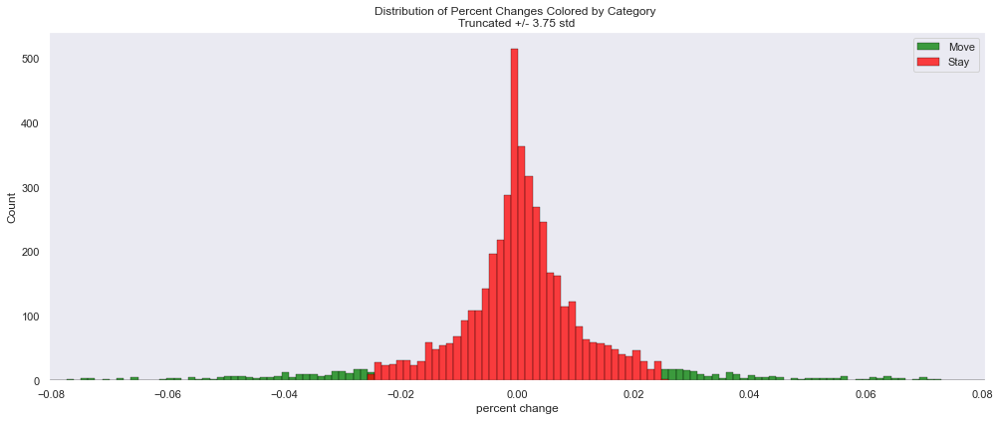

count    5034.000000
mean        0.000906
std         0.020104
min        -0.171089
25%        -0.004315
50%         0.000650
75%         0.006278
max         0.187531
Name: percent change, dtype: float64


In [44]:
# Define user, target, feature names
std = df['percent change'].std()
print('Value Counts:')
print(df[[target_name]].value_counts())
sns.set()
plt.figure(figsize=(15,6))
_ = sns.histplot(data = df, x='percent change',hue=target_name, stat='count', alpha=0.75, common_bins=True, palette=['red', 'green'], edgecolor='black')
plt.legend([0, 1, 2])
plt.title("Distribution of Percent Changes Colored by Category \nTruncated +/- 3.75 std")
plt.xlim(-4*std, 4*std)
plt.legend(['Move', 'Stay'])
plt.grid(False)
plt.savefig('./figures/modeling/{}_distribution.png'.format(target_name), bbox_inches='tight', transparent=True)
plt.savefig('./slides/figures/distribution_2pt5pct.png'.format(target_name), bbox_inches='tight', transparent=True)
plt.show()

print(df['percent change'].describe())

This dataset is imbalanced. The positive class (change) makes up only ~18% of data. As we are looking to see if Twitter data can predict that stocks will rise of fall within a certain percentage

In [45]:
%%time
# Clocked at 4min 5s

svm = SVC(probability = True, class_weight='balanced')
lgr = LogisticRegression(n_jobs=-1, class_weight='balanced')
nb = MultinomialNB()
clf_list = [svm, lgr, nb]

scores = cross_validation_scores(df, target_name, numerical_feat, text_name, clf_list)

CPU times: user 1min 49s, sys: 4.84 s, total: 1min 54s
Wall time: 2min 8s


In [46]:
cv_key =  "cv_1"
scores['n_features'] = len(numerical_feat)
cv_scores[cv_key] = scores
all_scores[col_name] = cv_scores

In [47]:
all_scores[col_name]['cv_1'].sort_values(by=['test_precision_mean'], ascending=False)

,username,model,fit_time_mean,fit_time_std,score_time_mean,score_time_std,test_balanced_accuracy_mean,test_balanced_accuracy_std,test_precision_mean,test_precision_std,test_recall_mean,test_recall_std,test_f1_mean,test_f1_std,test_roc_auc_mean,test_roc_auc_std,n_samples,n_pos_label,n_features
9,levie,"SVC(class_weight='balanced', probability=True)",0.405844,0.066793,0.129816,0.064212,0.550303,0.048728,0.390000,0.384708,0.133333,0.092962,0.193606,0.144539,0.500751,0.123445,320,44,15
6,richardbranson,"SVC(class_weight='balanced', probability=True)",3.013544,0.538336,0.492713,0.054718,0.741065,0.042421,0.380292,0.035190,0.615000,0.089443,0.468991,0.049630,0.843899,0.049929,665,78,15
7,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.404252,0.056149,0.078026,0.018371,0.749299,0.085669,0.372835,0.064093,0.640000,0.171255,0.469648,0.093553,0.840721,0.056880,665,78,15
4,elonmusk,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.602040,0.349903,0.053380,0.009772,0.540531,0.059422,0.332778,0.151388,0.203676,0.060834,0.247966,0.090170,0.538944,0.110379,418,84,15
3,elonmusk,"SVC(class_weight='balanced', probability=True)",1.184688,0.096033,0.174979,0.009779,0.520543,0.059335,0.293592,0.189572,0.166912,0.065126,0.207143,0.097299,0.428869,0.080470,418,84,15
16,JohnLegere,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.646982,0.041852,0.093707,0.027215,0.538104,0.006511,0.245556,0.150944,0.096364,0.004979,0.131249,0.023040,0.575052,0.038336,1093,52,15
1,jack,"LogisticRegression(class_weight='balanced', n_jobs=-1)",1.075066,1.064920,0.050605,0.015004,0.524702,0.039788,0.223864,0.095380,0.198901,0.089646,0.205210,0.080663,0.519670,0.061846,373,66,15
10,levie,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.373181,0.214308,0.050699,0.016779,0.528582,0.048353,0.208571,0.159520,0.133333,0.092962,0.162143,0.116935,0.543811,0.079399,320,44,15
0,jack,"SVC(class_weight='balanced', probability=True)",0.664204,0.177162,0.152116,0.046805,0.498300,0.035936,0.157143,0.144190,0.061538,0.064358,0.087059,0.086292,0.494104,0.056313,373,66,15
15,JohnLegere,"SVC(class_weight='balanced', probability=True)",8.804544,1.477383,1.331561,0.204747,0.518082,0.044494,0.133333,0.298142,0.040000,0.089443,0.061538,0.137604,0.610929,0.028609,1093,52,15


In [48]:
all_scores[col_name]['cv_1'][['username', 'model', 'test_precision_mean', 'test_recall_mean', 'test_roc_auc_mean', 'n_samples', 'n_pos_label']].sort_values(by=['username', 'test_precision_mean'], ascending=False).reset_index(drop=True)

,username,model,test_precision_mean,test_recall_mean,test_roc_auc_mean,n_samples,n_pos_label
0,richardbranson,"SVC(class_weight='balanced', probability=True)",0.380292,0.615000,0.843899,665,78
1,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.372835,0.640000,0.840721,665,78
2,richardbranson,MultinomialNB(),0.000000,0.000000,0.781491,665,78
3,levie,"SVC(class_weight='balanced', probability=True)",0.390000,0.133333,0.500751,320,44
4,levie,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.208571,0.133333,0.543811,320,44
5,levie,MultinomialNB(),0.000000,0.000000,0.515269,320,44
6,jack,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.223864,0.198901,0.519670,373,66
7,jack,"SVC(class_weight='balanced', probability=True)",0.157143,0.061538,0.494104,373,66
8,jack,MultinomialNB(),0.000000,0.000000,0.455686,373,66
9,elonmusk,"LogisticRegression(class_weight='balanced', n_jobs=-1)",0.332778,0.203676,0.538944,418,84


COLUMN: movement 
  CV_KEY: cv_1
richardbranson
Test_precision_mean: 0.380
Test_precision_std: 0.035
Range of test_precision_mean: 0.345 -- 0.415
SVC(class_weight='balanced', probability=True)
The mean cross-validation accuracy is: 0.836 +/- 0.022
Precision: 0.346
Recall: 0.545
Balanced accuracy: 0.705
              precision    recall  f1-score   support

           0       0.94      0.87      0.90       252
           1       0.35      0.55      0.42        33

    accuracy                           0.83       285
   macro avg       0.64      0.71      0.66       285
weighted avg       0.87      0.83      0.84       285



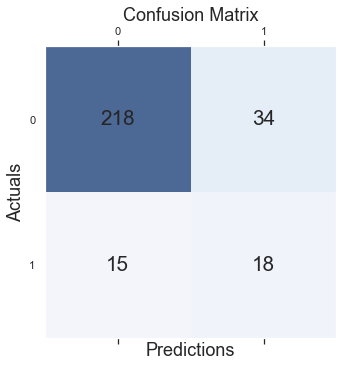

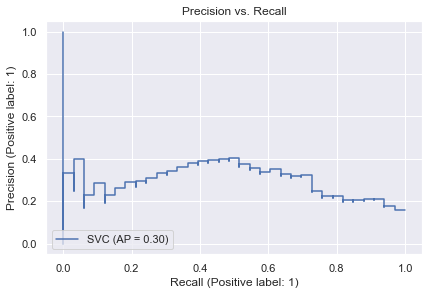

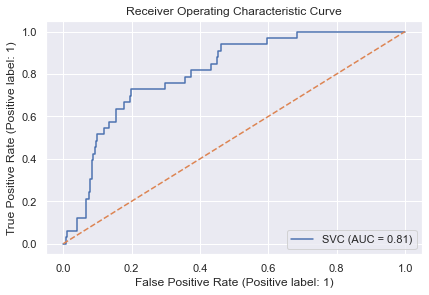

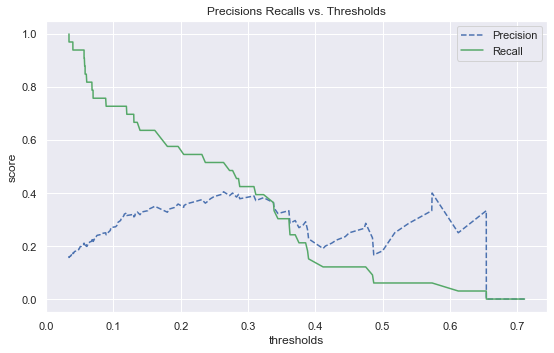

In [49]:
scorer = 'test_precision'
print("COLUMN: {} \n  CV_KEY: {}".format(col_name, cv_key))
_ = examine_model(df, all_scores[col_name][cv_key], scorer, target_name, numerical_feat, pos=1, reduce=False)

Had the shortest score time, highest balanced accuracy, precision, recall, and f1

COLUMN: movement 
  CV_KEY: cv_1
richardbranson
Test_f1_mean: 0.469
Test_f1_std: 0.050
Range of test_f1_mean: 0.419 -- 0.519
SVC(class_weight='balanced', probability=True)
The mean cross-validation accuracy is: 0.815 +/- 0.024
Precision: 0.404
Recall: 0.697
Balanced accuracy: 0.781
              precision    recall  f1-score   support

           0       0.96      0.87      0.91       252
           1       0.40      0.70      0.51        33

    accuracy                           0.85       285
   macro avg       0.68      0.78      0.71       285
weighted avg       0.89      0.85      0.86       285



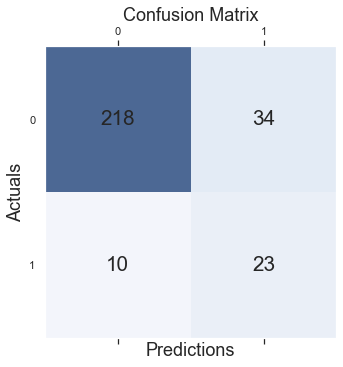

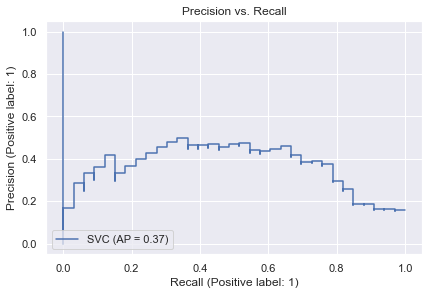

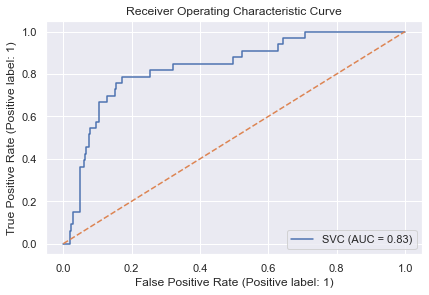

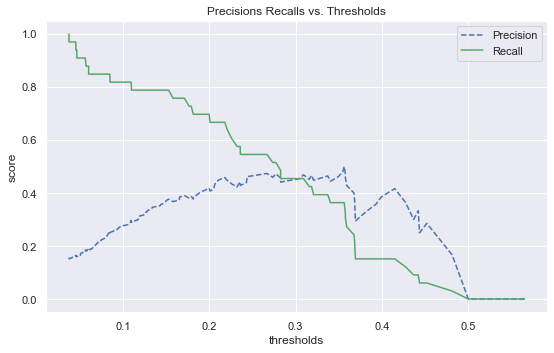

In [50]:
scorer = 'test_f1'
print("COLUMN: {} \n  CV_KEY: {}".format(col_name, cv_key))
_ = examine_model(df, all_scores[col_name][cv_key], scorer, target_name, numerical_feat, pos=1, reduce=False)

better ROC_AUC

COLUMN: movement 
  CV_KEY: cv_1
elonmusk
Test_f1_mean: 0.248
Test_f1_std: 0.090
Range of test_f1_mean: 0.158 -- 0.338
LogisticRegression(class_weight='balanced', n_jobs=-1)
The mean cross-validation accuracy is: 0.718 +/- 0.023
Precision: 0.190
Recall: 0.222
Balanced accuracy: 0.493
              precision    recall  f1-score   support

           0       0.80      0.76      0.78       144
           1       0.19      0.22      0.21        36

    accuracy                           0.66       180
   macro avg       0.49      0.49      0.49       180
weighted avg       0.68      0.66      0.67       180



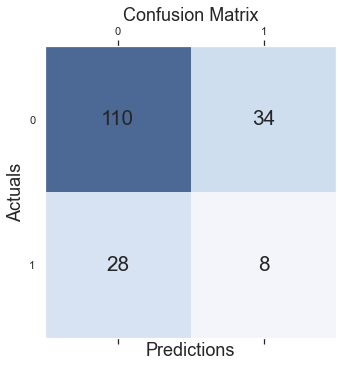

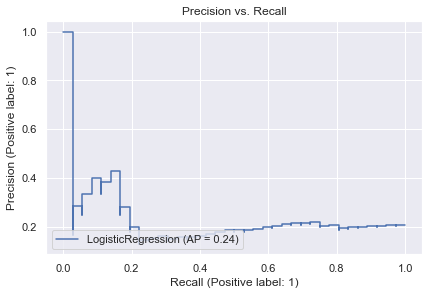

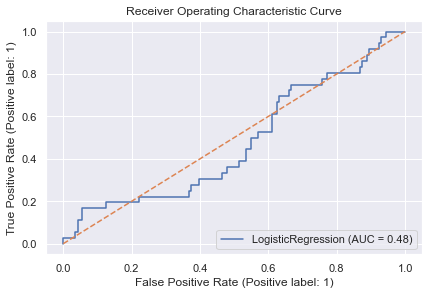

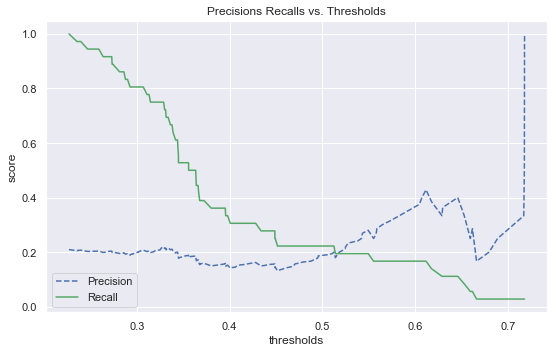

In [51]:
scorer = 'test_f1'
print("COLUMN: {} \n  CV_KEY: {}".format(col_name, cv_key))
_ = examine_model(df, all_scores[col_name][cv_key], scorer, target_name, numerical_feat, pos=2, reduce=False)

not good

# Hyperparameter Tuning

# Important Parameters for Logistic Regression Tuning

- C: Inverse of regularization strength 
    - constrains the size of the model coefficients (minimize model's overfitting to the training data by reducing the variance of the model, i.e. if a model is too complex, regularization will reduce the error due to variance more than it increases the error due to bias resulting in a model that is more likely to generalize to new data.
    - floating point number (1.0 by default). Increase regularization by making number smaller. Usually tuned in powers of 10 (e.g. .01, .1, 1, 10, 100)


- penalty: Type of regularization
    - l2 (default): ridge regression - shrinks coefficients, but remain non-zero
    - l1: lasso regression - shrinks coefficients to 0 (can be used for feature selection)
    - elasticnet: combination of l1 and l2
    
    
- solver: Algorithm used for optimization
    - Solves optimization problem of calculating coefficients
        - ‘newton-cg’ - [‘l2’, ‘none’]

        - ‘lbfgs’ - [‘l2’, ‘none’]

        - ‘liblinear’ - [‘l1’, ‘l2’] (Does not support multiclass)

        - ‘sag’ - [‘l2’, ‘none’]

        - ‘saga’ - [‘elasticnet’, ‘l1’, ‘l2’, ‘none’]
        
- other hyperparameters:
    - Dual: Dual formulation is only implemented for l2 penalty with liblinear solver.
    - Intercept Scaling: Useful only when the solver ‘liblinear’ is used and self.fit_intercept is set to True.
    - l1 Ratio: The Elastic-Net mixing parameter, with 0 <= l1_ratio <= 1. Only used if penalty='elasticnet'.

# Different Solvers

In [52]:
user = 'richardbranson'
df = df_training[df_training['username'] == user].copy(deep=True)
hyperparam_tuning = pd.DataFrame()
scoring = 'f1'
X, y = make_xy(df, target_name, numerical_feat, 'cleaned')
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size = 0.3, stratify=y)

#### lbfgs

In [53]:
%%time
# Clocked at 4min 9s

solver = 'lbfgs' # does not support l1 penalty
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'none'],
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.4751004749725977
solver: lbfgs
CPU times: user 23 s, sys: 6.13 s, total: 29.1 s
Wall time: 1min 26s


#### newton-cg

In [55]:
%%time
# Clocked at 4min 48s
solver = 'newton-cg' # does not support l1 penalty
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'none'],
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)


hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.4751004749725977
solver: newton-cg
CPU times: user 23 s, sys: 5.81 s, total: 28.8 s
Wall time: 1min 47s


#### sag

In [57]:
%%time
# Clocked at 5min 46s
solver = 'sag' 
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'none']
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.4751004749725977
solver: sag
CPU times: user 24.7 s, sys: 5.54 s, total: 30.2 s
Wall time: 5min 7s


#### saga

In [59]:
%%time
# Clocked at 10min 9s
solver = 'saga' 
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'l1', 'none']
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.4751004749725977
solver: saga
CPU times: user 35.9 s, sys: 7.82 s, total: 43.7 s
Wall time: 8min 15s


#### liblinear

In [61]:
%%time
# Clocked at 3min 17s
solver = 'liblinear' 
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'l1'], 'dual':[True, False], "intercept_scaling":[0.01, 0.01, 0.1, 1,10,100]
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2'}
best score : 0.48042797696014816
solver: liblinear
CPU times: user 4min 3s, sys: 23 s, total: 4min 26s
Wall time: 3min 3s


In [63]:
hyperparam_tuning = hyperparam_tuning.sort_values(by='mean_test_score', ascending=False).reset_index(drop=True)
hyperparam_tuning[:5]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_penalty,params,split0_test_score,split1_test_score,split2_test_score,...,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score,solver,clf,username,param_dual,param_intercept_scaling
0,0.077573,0.008242,0.029444,0.001170,1.0,l2,"{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2'}",0.421053,0.625000,0.5,...,0.47619,0.555556,0.480428,0.093811,1,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,10
1,0.522675,0.181372,0.034768,0.006232,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.47619,0.428571,0.475100,0.069165,1,lbfgs,"LogisticRegression(class_weight='balanced', n_jobs=-1)",richardbranson,NaN,NaN
2,0.592342,0.016959,0.031019,0.001459,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.47619,0.428571,0.475100,0.069165,1,newton-cg,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='newton-cg')",richardbranson,NaN,NaN
3,0.074684,0.007416,0.031695,0.002539,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 100, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.47619,0.428571,0.475100,0.069165,2,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,100
4,0.070130,0.004474,0.031311,0.002231,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.47619,0.428571,0.475100,0.069165,2,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,10


In [64]:
top_params = hyperparam_tuning['params'].iloc[0]
top_params['solver'] =  hyperparam_tuning['solver'].iloc[0]

params_lgr = top_params
#clf = LogisticRegression(n_jobs=-1, class_weight='balanced')
#clf.set_params(**params_lgr)

print(clf)
print(clf.get_params())

LogisticRegression(class_weight='balanced', dual=True, intercept_scaling=10,
                   n_jobs=-1, solver='liblinear')
{'C': 1.0, 'class_weight': 'balanced', 'dual': True, 'fit_intercept': True, 'intercept_scaling': 10, 'l1_ratio': None, 'max_iter': 100, 'multi_class': 'auto', 'n_jobs': -1, 'penalty': 'l2', 'random_state': None, 'solver': 'liblinear', 'tol': 0.0001, 'verbose': 0, 'warm_start': False}


# Important Parameters for SVC Tuning

SVM creates a decision boundary which makes the distinction between two or more classes. How to draw or determine the decision boundary is the most critical part in SVM algorithms. When the data points in different classes are linearly separable, it is an easy task to draw a decision boundary.

It is very significant to remember for SVM that the input data need to be normalized so that features are on the same scale and compatible.

0.0001 < gamma < 10
0.1 < c < 100

#### rbf

In [65]:
%%time
# Clocked at 11min
grid={
'C': np.logspace(-1,2,4), 'gamma': np.logspace(-4,1,6)
} 
kernel = 'rbf'


# Separate into Training/Testing
clf = SVC(class_weight='balanced', probability=True, kernel=kernel)
clf_cv=GridSearchCV(clf,grid,cv=5, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['kernel'] = kernel
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)

tuned hyperparameters :(best parameters)  {'C': 1.0, 'gamma': 0.1}
best score : 0.47379847933039426
CPU times: user 9min 25s, sys: 15.3 s, total: 9min 40s
Wall time: 10min 47s


### poly

In [67]:
%%time
# Clocked at 7min 34s
grid={
'C': np.logspace(-1,2,4), 'gamma': np.logspace(-4,1,6)
} 
kernel = 'poly'



clf = SVC(class_weight='balanced', probability=True, kernel=kernel)
clf_cv=GridSearchCV(clf,grid,cv=5, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['kernel'] = kernel
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)

tuned hyperparameters :(best parameters)  {'C': 10.0, 'gamma': 0.1}
best score : 0.4224522144522145
CPU times: user 6min 57s, sys: 4.34 s, total: 7min 1s
Wall time: 7min 20s


#### sigmoid

In [69]:
%%time
# Clocked at 7min 34s
grid={
'C': np.logspace(-1,2,4), 'gamma': np.logspace(-4,1,6)
} 
kernel = 'sigmoid'


clf = SVC(class_weight='balanced', probability=True, kernel=kernel)
clf_cv=GridSearchCV(clf,grid,cv=5, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['kernel'] = kernel
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)

tuned hyperparameters :(best parameters)  {'C': 1.0, 'gamma': 0.1}
best score : 0.4630690951421547
CPU times: user 7min 17s, sys: 4.36 s, total: 7min 21s
Wall time: 7min 45s


In [71]:
# Use best model

hyperparam_tuning = hyperparam_tuning.sort_values(by='mean_test_score', ascending=False).reset_index(drop=True)


hyperparam_tuning

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_penalty,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,solver,clf,username,param_dual,param_intercept_scaling,param_gamma,kernel
0,0.077573,0.008242,0.029444,0.001170,1.0,l2,"{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2', 'solver': 'liblinear'}",0.421053,0.625000,0.5,...,0.480428,0.093811,1,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,10,NaN,NaN
1,0.070130,0.004474,0.031311,0.002231,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.475100,0.069165,2,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,10,NaN,NaN
2,1.268582,0.040467,0.030555,0.000903,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.475100,0.069165,1,saga,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='saga')",richardbranson,NaN,NaN,NaN,NaN
3,1.799978,0.409347,0.056488,0.015195,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.475100,0.069165,1,sag,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='sag')",richardbranson,NaN,NaN,NaN,NaN
4,0.522675,0.181372,0.034768,0.006232,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.476190,0.588235,0.5,...,0.475100,0.069165,1,lbfgs,"LogisticRegression(class_weight='balanced', n_jobs=-1)",richardbranson,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,0.054805,0.004204,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 0.01, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,140,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,0.01,NaN,NaN
299,0.052155,0.000978,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 0.1, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,130,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,0.1,NaN,NaN
300,0.059557,0.005218,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 1, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,129,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,1,NaN,NaN
301,0.054846,0.004733,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,132,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,10,NaN,NaN


In [72]:
hyperparam_tuning['solver'].value_counts()

liblinear    168
saga          21
sag           14
lbfgs         14
newton-cg     14
Name: solver, dtype: int64

In [73]:
best_models = hyperparam_tuning.copy(deep=True)

In [74]:
best_models[['clf', 'params', 'solver', 'kernel', 'username', 'mean_test_score', 'std_test_score', 'mean_fit_time', 'mean_score_time']][:3]

,clf,params,solver,kernel,username,mean_test_score,std_test_score,mean_fit_time,mean_score_time
0,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2', 'solver': 'liblinear'}",liblinear,NaN,richardbranson,0.480428,0.093811,0.077573,0.029444
1,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",liblinear,NaN,richardbranson,0.475100,0.069165,0.070130,0.031311
2,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='saga')","{'C': 1.0, 'penalty': 'l2'}",saga,NaN,richardbranson,0.475100,0.069165,1.268582,0.030555


In [75]:
best_models['username'] = 'richardbranson'

In [76]:
best_models[['username', 'clf', 'params', 'solver', 'kernel','mean_test_score', 'std_test_score', 'mean_fit_time', 'mean_score_time']][:10]

,username,clf,params,solver,kernel,mean_test_score,std_test_score,mean_fit_time,mean_score_time
0,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2', 'solver': 'liblinear'}",liblinear,NaN,0.480428,0.093811,0.077573,0.029444
1,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",liblinear,NaN,0.475100,0.069165,0.070130,0.031311
2,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='saga')","{'C': 1.0, 'penalty': 'l2'}",saga,NaN,0.475100,0.069165,1.268582,0.030555
3,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='sag')","{'C': 1.0, 'penalty': 'l2'}",sag,NaN,0.475100,0.069165,1.799978,0.056488
4,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1)","{'C': 1.0, 'penalty': 'l2'}",lbfgs,NaN,0.475100,0.069165,0.522675,0.034768
5,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': False, 'intercept_scaling': 100, 'penalty': 'l2'}",liblinear,NaN,0.475100,0.069165,0.074684,0.031695
6,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='newton-cg')","{'C': 1.0, 'penalty': 'l2'}",newton-cg,NaN,0.475100,0.069165,0.592342,0.031019
7,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 0.1, 'dual': True, 'intercept_scaling': 0.1, 'penalty': 'l2'}",liblinear,NaN,0.473849,0.127795,0.065695,0.030040
8,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 0.1, 'dual': True, 'intercept_scaling': 0.01, 'penalty': 'l2'}",liblinear,NaN,0.473849,0.127795,0.075154,0.032391
9,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 0.1, 'dual': True, 'intercept_scaling': 0.01, 'penalty': 'l2'}",liblinear,NaN,0.473849,0.127795,0.076680,0.034592


In [77]:
clf = hyperparam_tuning['clf'].iloc[0]
hyperparam_tuning['params'].iloc[0]

{'C': 1.0,
 'dual': True,
 'intercept_scaling': 10,
 'penalty': 'l2',
 'solver': 'liblinear'}

In [78]:
clf.set_params = hyperparam_tuning['params'].iloc[0]

In [79]:
clf.get_params()

{'C': 1.0,
 'class_weight': 'balanced',
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': -1,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'liblinear',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

# Running on test data

In [80]:
# Separate Training from Testing
user = 'richardbranson'
train_data = df_training.copy(deep=True)
train_data = train_data[train_data['username']==user]
test_data = df_testing.copy(deep=True)
test_data = test_data[test_data['username']==user]
train_data.reset_index(inplace=True, drop=True)
train_idx = train_data.index
start = len(train_data)
stop = len(train_data)+len(test_data)
test_idx = np.arange(start, stop)
test_data.index = test_idx

target_name = 'classification'
text_name = 'cleaned'
col_name = 'bins' 

df = pd.concat([train_data, test_data])

In [81]:
%%time
X, y = make_xy(df,
    target_name,
    numerical_feat,
    text_name)

X_train = X.loc[train_idx]
X_test = X.loc[test_idx]
y_train = y.loc[train_idx]
y_test = y.loc[test_idx]

clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.85      0.89       380
           1       0.35      0.55      0.43        56

    accuracy                           0.81       436
   macro avg       0.64      0.70      0.66       436
weighted avg       0.85      0.81      0.83       436

[[322  58]
 [ 25  31]]
CPU times: user 351 ms, sys: 93.3 ms, total: 444 ms
Wall time: 447 ms


richardbranson
LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')
The mean cross-validation accuracy is: 0.822 +/- 0.012
Precision: 0.348
Recall: 0.554
Balanced accuracy: 0.700
              precision    recall  f1-score   support

           0       0.93      0.85      0.89       380
           1       0.35      0.55      0.43        56

    accuracy                           0.81       436
   macro avg       0.64      0.70      0.66       436
weighted avg       0.85      0.81      0.83       436



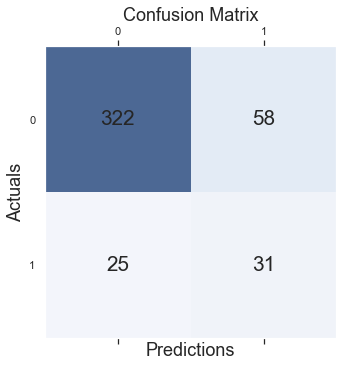

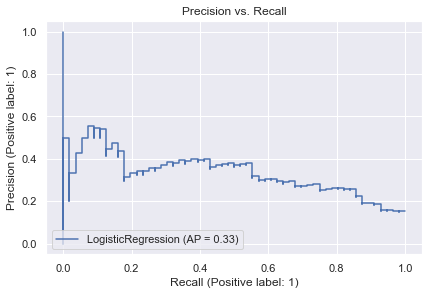

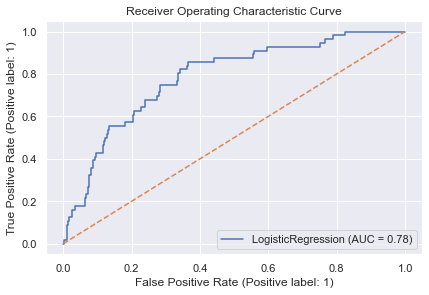

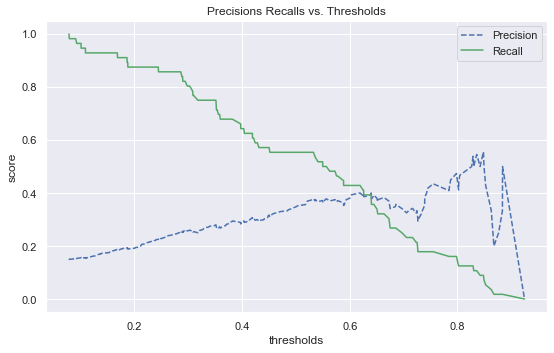

In [82]:
print(user)
print(clf)
full_report(clf, X_train, X_test, y_train, y_test)
y_proba = clf.predict_proba(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba[:,1])
plt.figure(figsize=[8,5])
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

In [83]:
%%time
f1_scores = []
for thresh in thresholds:
    y_pred = (clf.predict_proba(X_test)[:,1] >= thresh).astype(int)
    f1 = f1_score(y_test, y_pred, pos_label=1)
    f1_scores.append(f1)
f1_scores = np.array(f1_scores)

CPU times: user 26.3 s, sys: 2.21 s, total: 28.5 s
Wall time: 16.9 s


In [84]:
best_f1 = f1_scores.max()

In [85]:
best_f1

0.4492753623188406

In [86]:
idx = f1_scores.argsort()[-1]

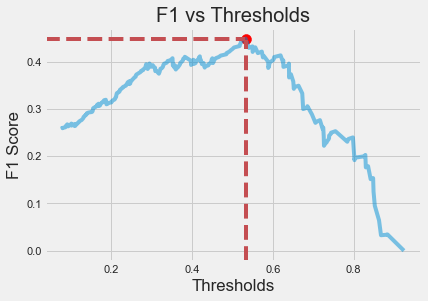

f1 score: 0.449
Threshold: 0.533


In [87]:
plt.style.use('fivethirtyeight')
plt.scatter(thresholds[idx], f1_scores[idx], color='red', alpha=1, s=100)
sns.lineplot(x=thresholds, y=f1_scores, alpha=0.5)
plt.xlabel('Thresholds')
plt.ylabel('F1 Score')
plt.title('F1 vs Thresholds')
plt.axvline(x=thresholds[idx], ymin=0, ymax=0.95, linestyle='--', c='r')
plt.axhline(y=best_f1, xmin=0, xmax=thresholds[idx], linestyle='--' ,c='r')
plt.show()

print('f1 score: {:.3f}\nThreshold: {:.3f}'.format(f1_scores[idx], thresholds[idx]))

Threshold: 0.351


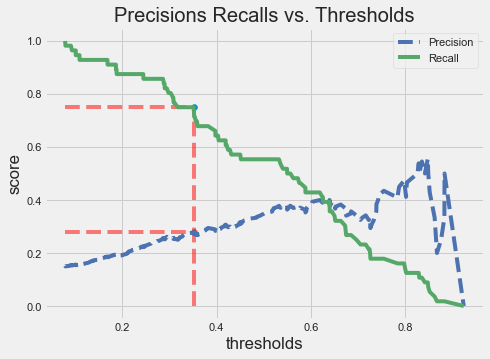

              precision    recall  f1-score   support

           0       0.95      0.72      0.82       380
           1       0.28      0.75      0.41        56

    accuracy                           0.72       436
   macro avg       0.62      0.73      0.61       436
weighted avg       0.86      0.72      0.76       436



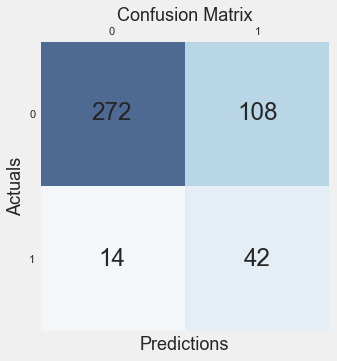

  Confusion Matrix Metrics
  How often is the classifier correct?
  Accuracy: 42.624%

  How often is it wrong?
  Error Rate: -41.624%

  When it's actually yes, how often does it predict yes?
  True Positive Rate (Recall): 75.000%

  When it predicts yes, how often is it correct?
  Precision: 28.000%

  When it's actually no, how often does it predict yes?
  False Positive Rate: 28.421%

  When it's actually no, how often does it predict no?
  True Negative Rate (Specificity): 71.579%
  F1 Score: 0.408
  Weighted F1 Score (beta = 2): 0.561
  G-mean: 0.458


In [88]:
thresh = plot_threshold(precisions, recalls, thresholds, clf, recall_thresh=0.74)

y_pred = (clf.predict_proba(X_test)[:,1] >= thresh).astype(int)
print(classification_report(y_test, y_pred))
plot_confusion_matrix(y_test, y_pred, show_metrics=True)

Threshold: 0.550


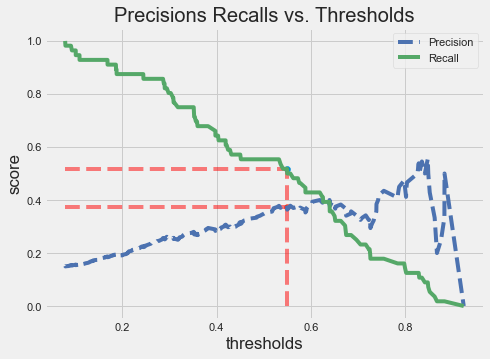

              precision    recall  f1-score   support

           0       0.92      0.87      0.90       380
           1       0.37      0.52      0.43        56

    accuracy                           0.83       436
   macro avg       0.65      0.69      0.66       436
weighted avg       0.85      0.83      0.84       436



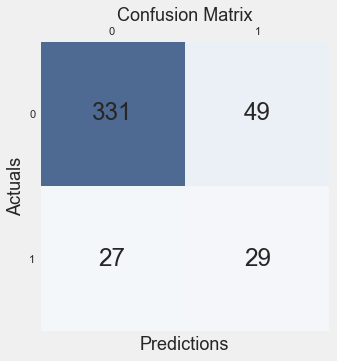

  Confusion Matrix Metrics
  How often is the classifier correct?
  Accuracy: 29.759%

  How often is it wrong?
  Error Rate: -28.759%

  When it's actually yes, how often does it predict yes?
  True Positive Rate (Recall): 51.786%

  When it predicts yes, how often is it correct?
  Precision: 37.179%

  When it's actually no, how often does it predict yes?
  False Positive Rate: 12.895%

  When it's actually no, how often does it predict no?
  True Negative Rate (Specificity): 87.105%
  F1 Score: 0.433
  Weighted F1 Score (beta = 2): 0.480
  G-mean: 0.439


In [89]:
thresh = plot_threshold(precisions, recalls, thresholds, clf, recall_thresh=0.5)

y_pred = (clf.predict_proba(X_test)[:,1] >= thresh).astype(int)
print(classification_report(y_test, y_pred))
plot_confusion_matrix(y_test, y_pred, show_metrics=True)

In [90]:
save_richardbranson = df.copy(deep=True)

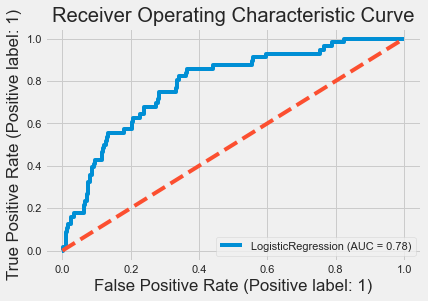

In [91]:
plot_roc_curve(clf, X_test, y_test, pos_label=1)
from sklearn.dummy import DummyClassifier
dummy_classifier = DummyClassifier(strategy="most_frequent")
dummy_classifier.fit(X_train, y_train)
y_score = dummy_classifier.predict_proba(X_test)
fpr, tpr, thresh = metrics.roc_curve(y_test, y_score[:,1])
auc = metrics.roc_auc_score(y_test, y_score[:,1])
plt.plot(fpr,tpr,label="data 2, auc="+str(auc), linestyle='--')
plt.title("Receiver Operating Characteristic Curve")
plt.show()

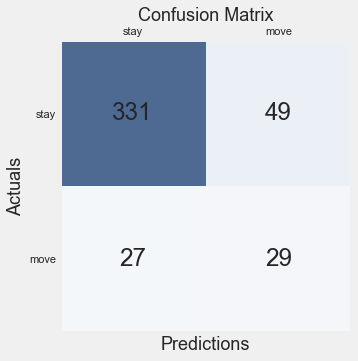

In [92]:
plt.style.use('fivethirtyeight')

mat = confusion_matrix(y_test, y_pred)
#https://vitalflux.com/python-draw-confusion-matrix-matplotlib/
fig, ax = plt.subplots(figsize=(5, 5))
ax.matshow(mat, cmap=plt.cm.Blues, alpha=0.7)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        ax.text(x=j, y=i,s=mat[i, j], va='center', ha='center', size='xx-large')

plt.xlabel('Predictions', fontsize=18)
plt.xticks(ticks = [0,1], labels = ['stay', 'move'])
plt.yticks(ticks = [0,1], labels = ['stay', 'move'])
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.grid(False)

plt.show()

# Interpretation

In [93]:
most_predictive_words(clf, train_data['cleaned'], train_data['bins'], min_df=1)


 Most Predictive Words for bin: move
     
                grow 0.69
               ocean 0.69
           fantastic 0.70
             promise 0.71
             america 0.72
                book 0.75
               dream 0.75
                 mum 0.75
              virgin 0.76
        conversation 0.83

 Most Predictive Words for bin: stay
     
             million 0.76
               thank 0.76
                need 0.78
               world 0.78
                love 0.79
                 way 0.80
              launch 0.81
                want 0.81
               quote 0.85
             support 0.86




In [94]:
text = train_data['cleaned']
target = train_data['bins']
vectorizer = TfidfVectorizer(min_df=1)
X = vectorizer.fit_transform(text)
y = target
clf.fit(X, y)



LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')

In [95]:
words_probs = pd.DataFrame()
words = np.array(vectorizer.get_feature_names())
x = np.eye(X.shape[1])
for i in range(len(clf.classes_)):
    probs = clf.predict_proba(x)[:, i]
    ind = np.argsort(probs)

    good_words = words[ind[-5:]]

    good_prob = probs[ind[-5:]]
    
    all_words = pd.DataFrame(columns=['words', 'probability', 'class'])
    all_words['words'] = good_words
    all_words['probability'] = good_prob
    all_words['class'] = clf.classes_[i]
    
    words_probs = words_probs.append(all_words)

    print("\n Most Predictive Words for bin: {}\n     ".format(clf.classes_[i]))
    for w, p in zip(good_words, good_prob):
        print("{:>20}".format(w), "{:.2f}".format(p))
print('\n')


 Most Predictive Words for bin: move
     
                book 0.75
               dream 0.75
                 mum 0.75
              virgin 0.76
        conversation 0.83

 Most Predictive Words for bin: stay
     
                 way 0.80
              launch 0.81
                want 0.81
               quote 0.85
             support 0.86




Text(0.5, 1.0, 'Most Predictive Words per Class')

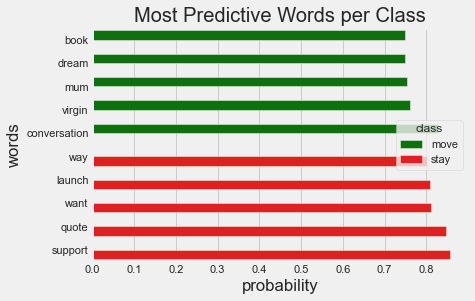

In [96]:
words_probs

sns.barplot(y='words', x='probability', data=words_probs, hue='class', palette=['green', 'red'])
plt.title('Most Predictive Words per Class')

In [97]:
target_word = 'virgin'
i = get_index(test_data['cleaned'], target_word)
test_data['tweet'].loc[i]

'How a @VirginAtlantic cabin crew member pitched a great business idea that launched a @Virgin company  https://t.co/y0aiQrSfNO  https://t.co/hG9rJbOsFa Shaving my beard is not something I do lightly – nor is wearing a wedding dress!  https://t.co/y0aiQrSfNO  https://t.co/unvOJpepKk Remembering Virgin Brides ten years after it closed its doors for the last time  https://t.co/y0aiQrSfNO  https://t.co/SipqpSEuz6 Employees are human beings, not resources:  https://t.co/963b6mUwKg 100% #HumanAtWork  https://t.co/bTzPn31ORt Bears Ears are the bee’s knees – supporting the efforts to protect US national monuments  https://t.co/RKdT9yHJ2q #MonumentsForAll #StandWithBearsEars #SaveGrandStaircase  https://t.co/uVmBWT0cdl '

[[0.62362182 0.37637818]]
Document id: 952
Percent Change: 0.001
Probability(Change) = 0.407
True class: stay


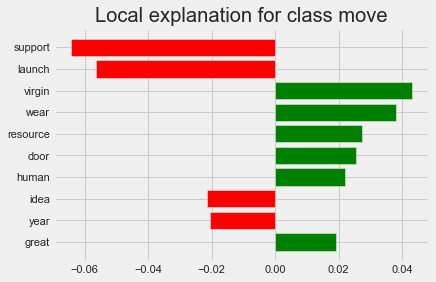

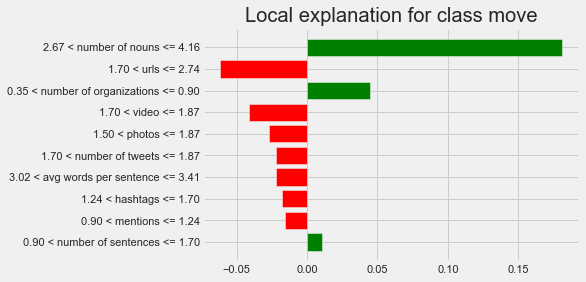

In [98]:
idx = i
class_names = ['stay', 'move']
interpret_instance(clf, train_data, test_data, class_names, idx, numerical_feat, 10)

In [99]:
def feat_prob_visual(clf, train_data, test_data, class_names, features,
                     idx_id, num_features): 

    
    indx_l = list(test_data.index)
    idx = indx_l.index(idx_id)
    
    X_train = train_data[features]
    X_test = test_data[features]
    y_train = train_data['classification']
    y_test = test_data['classification']
    #clf = lgr_cv.best_estimator_
    #clf = RandomForestClassifier(n_jobs=-1)
    clf.fit(X_train, y_train)
    pred = clf.predict(X_test)
    

    lime_explainer = lime_tabular.LimeTabularExplainer(
        X_train.values,
        training_labels=y_train.values,
        feature_names=X_train.columns.tolist(),
        feature_selection="lasso_path",
        class_names=class_names,
        discretize_continuous=True,
        discretizer="entropy",
    )

    exp = lime_explainer.explain_instance(X_test.iloc[idx], clf.predict_proba, num_features=num_features)

    exp.show_in_notebook(show_table=True)
    exp.as_pyplot_figure()
    plt.grid(False)
    plt.xticks(size=15)
    plt.yticks(size=15)
    plt.savefig('./figures/modeling/feat_explainer_{}.png'.format(idx_id), bbox_inches='tight', transparent=True)
    plt.savefig('./slides/figures/feat_explainer_test.png'.format(idx_id), bbox_inches='tight', transparent=True)

In [100]:
def text_prob_visual(clf, train_data, test_data, class_names, text_idx, num_features): 
    idx = text_idx
    vectorizer = TfidfVectorizer(lowercase=False)
    train_vectors = vectorizer.fit_transform(train_data['cleaned'])
    test_vectors = vectorizer.transform(test_data['cleaned'])
    y_train= train_data['classification']
    y_test = test_data['classification']
    clf.fit(train_vectors, y_train)
    pred = clf.predict(test_vectors)
    f1_score(y_test, pred, average='binary')
    c = make_pipeline(vectorizer, clf)
    print(c.predict_proba([test_data['cleaned'].iloc[0]]))
    #class_names = ['no change', 'change']
    explainer = LimeTextExplainer(class_names=class_names)
    
    exp = explainer.explain_instance(test_data['cleaned'][idx], c.predict_proba, num_features=num_features)
    print('Document id: %d' % idx)
    print('Percent Change: {:.3f}'.format(test_data['percent change'][idx]))
    print('Probability(Change) = {:.3f}'.format(c.predict_proba([test_data['text'][idx]])[0,1]))
    print('True class: %s' % class_names[y_test[idx]])
    exp.show_in_notebook(text=True)
    exp.as_pyplot_figure()
    plt.grid(False)
    plt.xticks(size=15)
    plt.yticks(size=15)
    plt.savefig('./figures/modeling/text_explainer_{}.png'.format(text_idx), bbox_inches='tight', transparent=True)
    plt.savefig('./slides/figures/text_explainer_test.png'.format(text_idx), bbox_inches='tight', transparent=True)

New article about this drop:
https://www.cnbc.com/2021/07/12/virgin-galactic-shares-rise-after-successful-branson-flight-paves-wave-for-space-tourism-industry.html

In [101]:
classifications = pd.DataFrame()
classifications['actual'] = y_test.copy(deep=True)
classifications['percent change'] = test_data['percent change']
classifications['y_pred'] = y_pred
classifications['y_proba_1'] = y_proba[:,1]
misclassifications = classifications[classifications['actual'] != classifications['y_pred']]
correct_classifications = classifications[classifications['actual'] == classifications['y_pred']]
print('Incorrectly predicted actual {} as {} {} times'.format(labels[1].upper(),labels[0].upper(),len(misclassifications[misclassifications['actual'] == 1])))
print('Top 5 misclassifications')
misclassifications[misclassifications['actual'] == 1].sort_values(by='y_proba_1')[:5]

Incorrectly predicted actual MOVE as STAY 27 times
Top 5 misclassifications


,actual,percent change,y_pred,y_proba_1
1380,1,0.033033,0,0.078483
1206,1,-0.038095,0,0.090861
1100,1,0.042839,0,0.100997
1076,1,-0.040061,0,0.108996
1034,1,0.026756,0,0.168362


In [102]:
classifications[classifications['actual'] == 1].sort_values(by='percent change')

,actual,percent change,y_pred,y_proba_1
1207,1,-0.178809,1,0.848369
1003,1,-0.176000,0,0.428438
1218,1,-0.151361,0,0.186252
1221,1,-0.102003,0,0.381991
1126,1,-0.091488,0,0.286289
1146,1,-0.087209,0,0.421411
1110,1,-0.085040,1,0.640084
1087,1,-0.079808,1,0.644735
1175,1,-0.079340,1,0.755006
1330,1,-0.076119,0,0.187589


We raised £1m for @bigchange_ on the @virgin @strivechallenge - well done everyone!  https://t.co/SZ9Dn02Lq7 #westrive  https://t.co/oCFLeJaOgw If you haven’t cycled, I really recommend you do – it's so much fun and one of the best ways of looking after your body  https://t.co/tLTGGBsiOS  https://t.co/XDP7cMOz9J 
2018-10-08 16:00:00


[[0.62362182 0.37637818]]
Document id: 1031
Percent Change: 0.001
Probability(Change) = 0.417
True class: stay


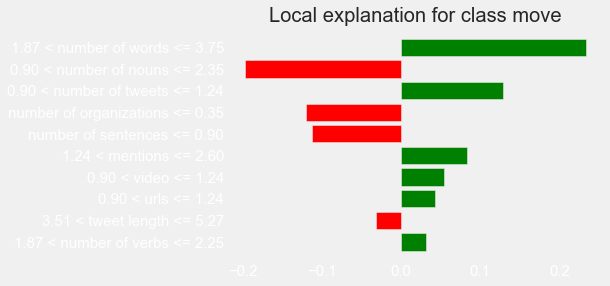

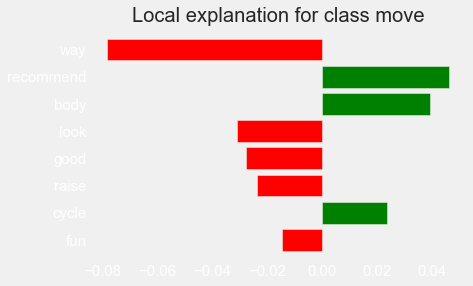

In [104]:
idx = 1031
print(test_data['tweet'].loc[idx])
print(test_data['date'].loc[idx])
class_names = ['stay', 'move']
feat_prob_visual(clf, train_data, test_data, class_names, numerical_feat, idx,  10)
text_prob_visual(clf, train_data, test_data, class_names, idx, 10)

In [106]:
idx = misclassifications[misclassifications['actual'] == 1].sort_values(by='y_proba_1').index[0]
test_data['tweet'].loc[idx]

'Love the businesses the Branson Centre of Entrepreneurship South Africa is supporting, from I Love Coffee, which employs people who are hearing-impaired, to beach clean-up upcycling non-profit Clean C  https://t.co/36za0EqhOr @BransonCentreSA @VirginActiveSA @Ilovecoffeeshop  https://t.co/Vr5B5hL2ra A real #VirginFamily affair as we launched the Branson Centre at Mont Rochelle with the support of all the team, Virgin Active &amp; Virgin Atlantic  https://t.co/36za0EqhOr @BransonCentre @VirginActiveSA @VirginAtlantic  https://t.co/j8F9qqh51z @EveBranson @HollyBranson 👩\u200d✈️#SeeHerFly Listen to #EarthUnscrewed to learn how @VirginAtlantic are taking #climateaction – and what you can do to help:  https://t.co/VIs0QKsKXX #Podcasts  https://t.co/NEgqRpwFbW It’s time to end the death penalty:  https://t.co/BVX5YriGQo So encouraging to see how fishing boundaries and coral gardeners are helping to restore Jamaica’s depleting coral reefs:  https://t.co/mSZlc8OJuu #ReadByRichard  https://t.c

[[0.62362182 0.37637818]]
Document id: 1380
Percent Change: 0.033
Probability(Change) = 0.303
True class: move


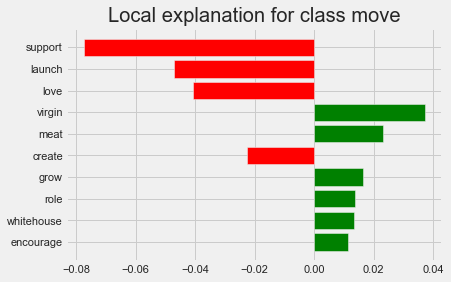

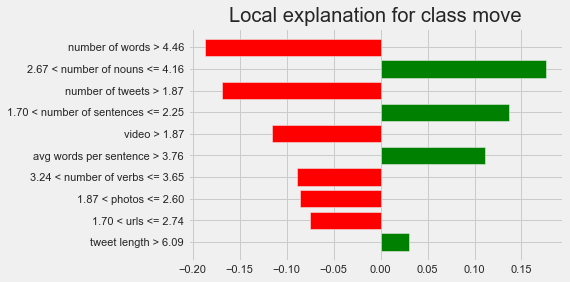

In [107]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)

In [108]:
# Greatest Change% Disparity

np.abs(misclassifications[misclassifications['actual'] == 1]).sort_values(by='percent change', ascending=False)[:5]

,actual,percent change,y_pred,y_proba_1
1125,1,0.232461,0,0.403132
1003,1,0.176000,0,0.428438
1218,1,0.151361,0,0.186252
1221,1,0.102003,0,0.381991
1126,1,0.091488,0,0.286289


In [109]:
idx = np.abs(misclassifications[misclassifications['actual'] == 1]).sort_values(by='percent change', ascending=False).index[0]
print('Predicted to be {} with {:.2f}% probability. Stock change is {:.2f}% '.format(labels[1].upper(), misclassifications['y_proba_1'].loc[idx] * 100, misclassifications['percent change'].loc[idx] *100))
#test_data['tweet'].loc[idx]

Predicted to be MOVE with 40.31% probability. Stock change is 23.25% 


In [110]:
test_data['tweet'].loc[idx]

"When we return from space, I will announce something very exciting to give more people the chance to become an astronaut. Because space belongs to us all. So watch this space…   https://t.co/x0ksfnuEQ3 #Unity22  https://t.co/caW3M3WEHG For the first time, Virgin Galactic will share a global livestream of the spaceflight. Head over to @VirginGalactic to join us as we welcome the next era of space travel  https://t.co/x0ksfnuEQ3 #Unity22  https://t.co/hHxLikFHb6 It’s one thing to have a dream of making space more accessible to all; it’s another for an incredible team to collectively turn that dream into reality  https://t.co/x0ksfnuEQ3 #Unity22 @virgingalactic  https://t.co/3ecEWGXQPp I am so proud and excited to be flying to space on @virgingalactic's next rocket-powered test flight as part of a remarkable crew of mission specialists  https://t.co/x0ksfnd3rt #Unity22  https://t.co/xWSnb6He9K I’ve always been a dreamer. My mum taught me to never give up and to reach for the stars. On Ju

[[0.62362182 0.37637818]]
Document id: 1125
Percent Change: 0.232
Probability(Change) = 0.540
True class: move


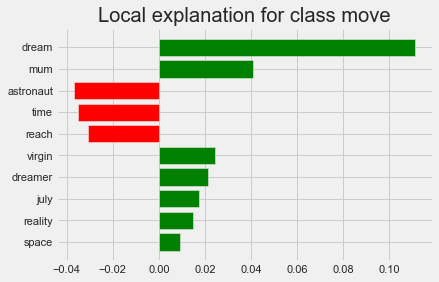

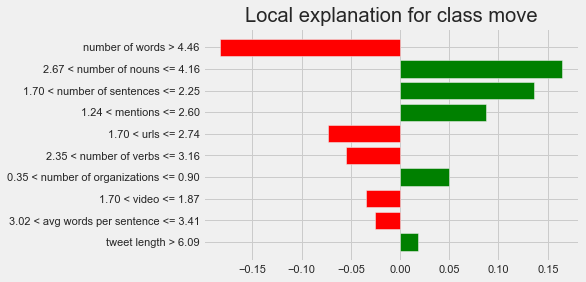

In [111]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)

In [112]:
print('Incorrectly predicted actual {} as {} {} times'.format(labels[0].upper(),labels[1].upper(),len(misclassifications[misclassifications['actual'] == 0])))
print('Top 5 misclassifications')
misclassifications[misclassifications['actual'] == 0].sort_values(by='y_proba_1', ascending=False)[:5]

Incorrectly predicted actual STAY as MOVE 49 times
Top 5 misclassifications


,actual,percent change,y_pred,y_proba_1
1196,0,0.004274,1,0.924711
1054,0,-0.000268,1,0.883647
1325,0,0.019958,1,0.876565
1248,0,0.000787,1,0.867833
1273,0,-0.003351,1,0.842186


In [113]:
idx = misclassifications[misclassifications['actual'] == 0].sort_values(by='y_proba_1', ascending=False).index[0]
test_data['tweet'].loc[idx]

'Proud dad! '

In [114]:
test_data.loc[idx]

date                       2020-12-04 09:30:00
tweet                              Proud dad! 
username                        richardbranson
mentions                                   0.0
hashtags                                   0.0
video                                      0.0
photos                                     0.0
urls                                       0.0
number of tweets                      0.693147
price                                28.200001
percent change                        0.004274
bins                                      stay
text                                Proud dad!
number of emojis                           0.0
tweet length                          2.397895
number of sentences                   0.693147
number of words                       1.098612
avg words per sentence                1.098612
number of nouns                       0.693147
number of verbs                            0.0
number of stopwords                        0.0
number of org

[[0.62362182 0.37637818]]
Document id: 1196
Percent Change: 0.004
Probability(Change) = 0.567
True class: stay


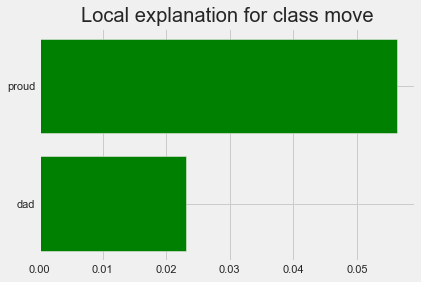

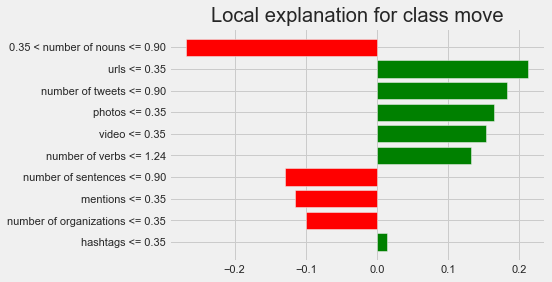

In [115]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)
#text_prob_visual_test(clf, train_data, test_data, labels, idx, numerical_feat)

In [116]:
idx = np.abs(misclassifications[misclassifications['actual'] == 0]).sort_values(by='percent change').index[0]
print('Predicted to be {} with {:.2f}% probability. Stock change is {:.2f}% '.format(labels[1].upper(), misclassifications['y_proba_1'].loc[idx] * 100, misclassifications['percent change'].loc[idx] *100))
test_data['tweet'].loc[idx]

Predicted to be MOVE with 59.10% probability. Stock change is 0.00% 


'Is it time to start harnessing hyperconnectivity across all parts of business?  https://t.co/KvBSIU8UcZ #ReadbyRichard  https://t.co/bUEAa1yjiN '

[[0.62362182 0.37637818]]
Document id: 1379
Percent Change: 0.000
Probability(Change) = 0.395
True class: stay


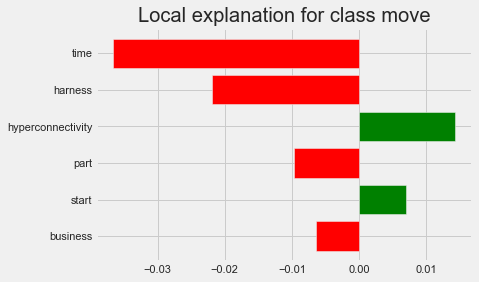

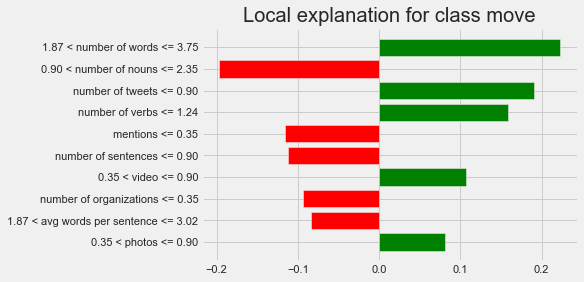

In [117]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)

In [118]:
best_lgr_classifications = classifications
classifications

,actual,percent change,y_pred,y_proba_1
950,0,0.010290,0,0.369257
951,0,0.000000,0,0.180747
952,0,0.001006,0,0.221015
953,1,-0.063956,1,0.696873
954,0,0.004818,1,0.705497
...,...,...,...,...
1381,0,0.008081,0,0.258898
1382,1,-0.031915,0,0.450267
1383,0,0.000000,0,0.054875
1384,1,0.134672,1,0.849393


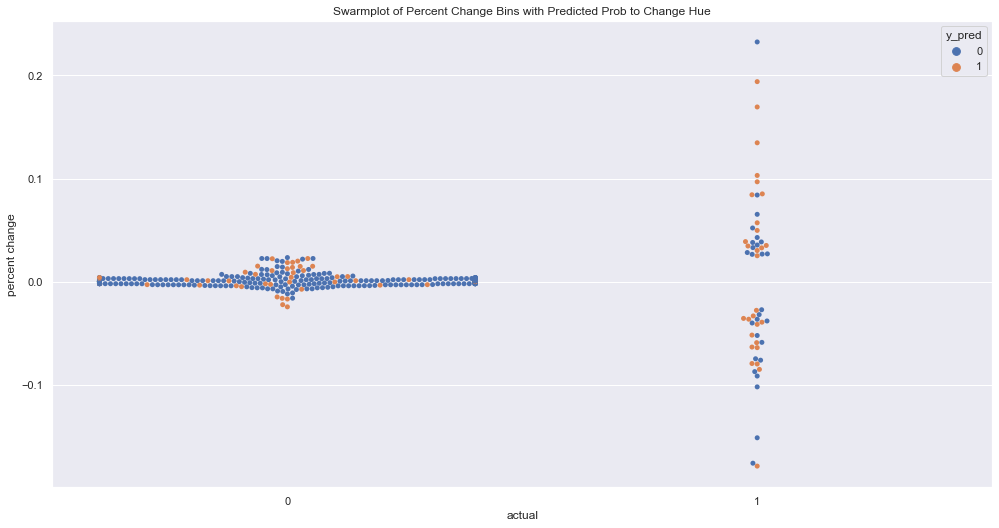

In [119]:
sns.set()
fig, ax = plt.subplots(figsize=(15,8))
ax = sns.swarmplot(y="percent change", x='actual', hue="y_pred", data=classifications, size=5)
norm = plt.Normalize(classifications['y_proba_1'].min(), classifications['y_proba_1'].max())

# Remove the legend and add a colorbar
ax.get_legend()
plt.title('Swarmplot of Percent Change Bins with Predicted Prob to Change Hue')
plt.savefig('./figures/modeling/swarmplot_cat.png', bbox_inches='tight')

plt.show()

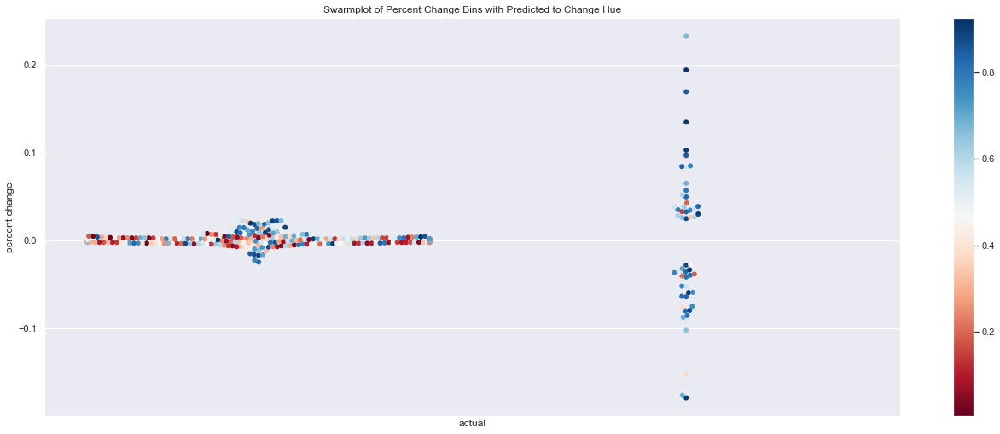

In [120]:
#### sns.set()
fig, ax = plt.subplots(figsize=(20,8))
ax = sns.swarmplot(y="percent change", x='actual', hue="y_proba_1", palette='RdBu', data=classifications, size=6)
norm = plt.Normalize(classifications['y_proba_1'].min(), classifications['y_proba_1'].max())
sm = plt.cm.ScalarMappable(cmap="RdBu", norm=norm)
sm.set_array([])

# Remove the legend and add a colorbar
ax.get_legend().remove()
ax.figure.colorbar(sm)
plt.title('Swarmplot of Percent Change Bins with Predicted to Change Hue')
plt.xticks(ticks=[])
plt.savefig('./figures/modeling/swarmplot_pred.png', bbox_inches='tight', transparent=True)

plt.show()

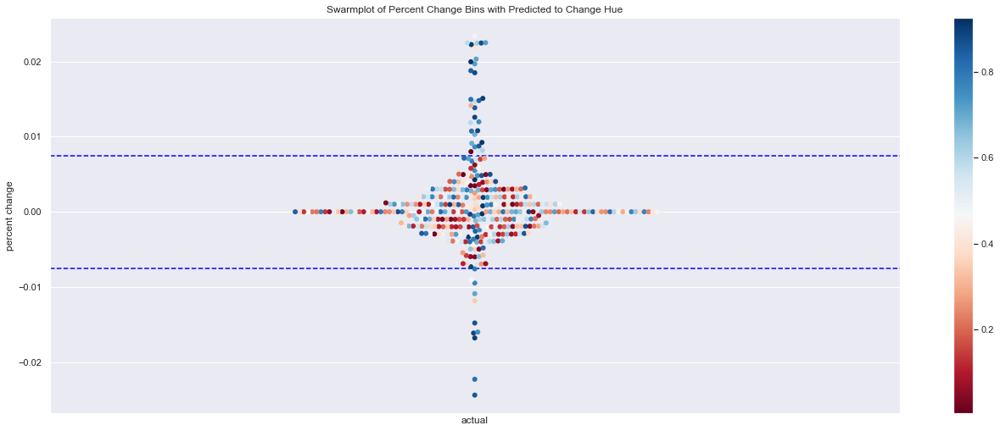

In [121]:
#### sns.set()
classifications = best_lgr_classifications
data = classifications[classifications['actual'] == 0]
fig, ax = plt.subplots(figsize=(20,8))
ax = sns.swarmplot(y="percent change", x='actual', hue="y_proba_1", palette='RdBu', data=data, size=6)
norm = plt.Normalize(classifications['y_proba_1'].min(), classifications['y_proba_1'].max())
sm = plt.cm.ScalarMappable(cmap="RdBu", norm=norm)
sm.set_array([])

# Remove the legend and add a colorbar
ax.get_legend().remove()
plt.hlines(y=0.0075, xmin=-1.0, xmax=1.0, linestyles='--', color='blue')
plt.hlines(y=-0.0075, xmin=-1.0, xmax=1.0, linestyles='--', color='blue')
ax.figure.colorbar(sm)
plt.title('Swarmplot of Percent Change Bins with Predicted to Change Hue')
plt.xticks(ticks=[])
plt.savefig('./figures/modeling/swarmplot_pred_0.png', bbox_inches='tight', transparent=True)
plt.show()

In [122]:
chi2_sig(df, bin_name, numerical_feat, 'cleaned')

Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 12
  . top features: blow,conversation,bubble,breathtake,rocketpowered,aha,promise,burden,whitehouse,scenery
 
# stay:
  . selected features: 12
  . top features: blow,conversation,bubble,breathtake,rocketpowered,aha,promise,burden,whitehouse,scenery
 
Statistically Significant Features Per Bin
P_val = 0.95

# move:
  . selected features: 6
  . top features: photos,number of tweets,video,urls,number of verbs,hashtags
 
# stay:
  . selected features: 6
  . top features: photos,number of tweets,video,urls,number of verbs,hashtags
 
